In [1]:
# 1. Configuración inicial y carga de paquetes
using Pkg
Pkg.activate(".")



  Activating project at `e:\FFA-FINAL`


In [2]:
using MLJ, DataFrames, Statistics, Random
using CSV, Dates, CategoricalArrays
using MLJLinearModels, DecisionTree, NearestNeighborModels, LIBSVM, LightGBM,MLJLIBSVMInterface




┌ Info: lib_lightgbm found in system dirs!
└ @ LightGBM C:\Users\abelf\.julia\packages\LightGBM\xQZ0z\src\LightGBM.jl:32


In [49]:
using Pkg
Pkg.status(["MLJ", "DecisionTree", "MLJBase"])

In [3]:
using EvoTrees

In [7]:
# CÓDIGO COMPLETO FINAL - Con encoding de variables categóricas
using MLJ, DataFrames, CSV, Statistics, Dates, Random, CategoricalArrays
using MLJ: @load, machine, fit!, predict
using EvoTrees

# ========================================
# 1. CARGA Y PROCESAMIENTO DE DATOS
# ========================================

# Cargar datos desde carpeta dataO
df_train = DataFrame(CSV.File("dataO/train_data.csv"))
df_week = DataFrame(CSV.File("dataO/date_to_week_id_map.csv"))
df_prices = DataFrame(CSV.File("dataO/product_prices.csv"))

# Realizar joins
df = innerjoin(df_prices, df_week, on = :week_id)
df_final = innerjoin(df_train, df, on = [:date, :product_identifier, :outlet])

# Preparar features con encoding de variables categóricas
using CategoricalArrays

# Convertir a categóricas
df_final.category_of_product = categorical(df_final.category_of_product)
df_final.state = categorical(df_final.state)

# Crear encodings
df_final.state_encoded = levelcode.(df_final.state)
df_final.category_encoded = levelcode.(df_final.category_of_product)
df_final.Month = month.(df_final.date)

# Seleccionar features incluyendo las variables categóricas encodificadas
X = select(df_final, [:product_identifier, :department_identifier, :outlet, 
                      :sell_price, :Month, :state_encoded, :category_encoded])
y = df_final.sales

# División train/test reproducible (70/30)
Random.seed!(42)
n = nrow(X)
train_size = floor(Int, 0.7 * n)
perm = randperm(n)

X_train = X[perm[1:train_size], :]
X_test = X[perm[train_size+1:end], :]
y_train = y[perm[1:train_size]]
y_test = y[perm[train_size+1:end]]

# Verificar dimensiones de los datos
data_summary = (
    total_rows = nrow(df_final),
    features = ncol(X),
    train_size = nrow(X_train),
    test_size = nrow(X_test),
    feature_names = names(X)
)

# ========================================
# 2. CARGA DE MODELOS
# ========================================

# Cargar todos los modelos funcionales
@load LinearRegressor pkg=MLJLinearModels verbosity=0
@load RidgeRegressor pkg=MLJLinearModels verbosity=0
@load LassoRegressor pkg=MLJLinearModels verbosity=0
@load KNNRegressor pkg=NearestNeighborModels verbosity=0
@load EvoTreeRegressor pkg=EvoTrees verbosity=0

# ========================================
# 3. DEFINICIÓN DE MODELOS
# ========================================

# Arsenal completo de modelos con diferentes configuraciones
all_models = Dict(
    # Modelos lineales
    "LinearRegression" => LinearRegressor(),
    "Ridge_0.1" => RidgeRegressor(lambda=0.1),
    "Ridge_1.0" => RidgeRegressor(lambda=1.0),
    "Ridge_10.0" => RidgeRegressor(lambda=10.0),
    "Lasso_0.1" => LassoRegressor(lambda=0.1),
    "Lasso_1.0" => LassoRegressor(lambda=1.0),
    "Lasso_10.0" => LassoRegressor(lambda=10.0),
    
    # K-Nearest Neighbors
    "KNN_5" => KNNRegressor(K=5),
    "KNN_10" => KNNRegressor(K=10),
    "KNN_15" => KNNRegressor(K=15),
    "KNN_25" => KNNRegressor(K=25),
    "KNN_35" => KNNRegressor(K=35),
    
    # Evolutionary Trees (Gradient Boosting)
    "EvoTree_50" => EvoTreeRegressor(nrounds=50),
    "EvoTree_100" => EvoTreeRegressor(nrounds=100),
    "EvoTree_200" => EvoTreeRegressor(nrounds=200)
)

# ========================================
# 4. ENTRENAMIENTO Y EVALUACIÓN
# ========================================

# DataFrame para almacenar resultados
ultimate_results = DataFrame(
    Model = String[],
    MAE = Float64[],
    MSE = Float64[],
    RMSE = Float64[],
    R2 = Float64[],
    Training_Time = Float64[]
)

# Entrenar y evaluar cada modelo
for (name, model) in all_models
    start_time = time()
    
    # Entrenar modelo
    mach = machine(model, X_train, y_train)
    fit!(mach, verbosity=0)
    
    training_time = time() - start_time
    
    # Realizar predicciones
    ŷ = predict(mach, X_test)
    
    # Calcular métricas
    mae_val = mean(abs.(ŷ .- y_test))
    mse_val = mean((ŷ .- y_test).^2)
    rmse_val = sqrt(mse_val)
    r2_val = 1 - sum((y_test .- ŷ).^2) / sum((y_test .- mean(y_test)).^2)
    
    # Agregar resultados
    push!(ultimate_results, (name, mae_val, mse_val, rmse_val, r2_val, training_time))
end

# ========================================
# 5. RESULTADOS FINALES
# ========================================

# Ordenar por RMSE (menor es mejor)
final_ranking = sort(ultimate_results, :RMSE)

# Mostrar resumen de datos y ranking final
(data_summary = data_summary, ranking = final_ranking)

┌ Warning: The number and/or types of data arguments do not match what the specified model
│ supports. Suppress this type check by specifying `scitype_check_level=0`.
│ 
│ Run `@doc EvoTrees.EvoTreeRegressor` to learn more about your model's requirements.
│ 
│ Commonly, but non exclusively, supervised models are constructed using the syntax
│ `machine(model, X, y)` or `machine(model, X, y, w)` while most other models are
│ constructed with `machine(model, X)`.  Here `X` are features, `y` a target, and `w`
│ sample or class weights.
│ 
│ In general, data in `machine(model, data...)` is expected to satisfy
│ 
│     scitype(data) <: MLJ.fit_data_scitype(model)
│ 
│ In the present case:
│ 
│ scitype(data) = Tuple{Table{Union{AbstractVector{Continuous}, AbstractVector{Count}}}, AbstractVector{Count}}
│ 
│ fit_data_scitype(model) = Union{Tuple{Union{Table{<:Union{AbstractVector{<:Continuous}, AbstractVector{<:Count}, AbstractVector{<:OrderedFactor}, AbstractVector{<:Multiclass}}}, AbstractMa

(data_summary = (total_rows = 395000,
                 features = 7,
                 train_size = 276500,
                 test_size = 118500,
                 feature_names = ["product_identifier", "department_identifier", "outlet", "sell_price", "Month", "state_encoded", "category_encoded"],),
 ranking = 15×6 DataFrame
 Row │ Model             MAE      MSE       RMSE     R2          Training_Time ⋯
     │ String            Float64  Float64   Float64  Float64     Float64       ⋯
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ KNN_35            1.07139   8.16223  2.85696   0.373898       0.0810001 ⋯
   2 │ EvoTree_200       1.10103   8.16419  2.8573    0.373748       2.765
   3 │ EvoTree_100       1.12776   8.29465  2.88004   0.36374        1.355
   4 │ KNN_25            1.06201   8.31114  2.88291   0.362475       0.0630002
   5 │ KNN_15            1.06371   8.45142  2.90713   0.351714       0.069     ⋯
   6 │ EvoTree_50        1.16948   8.48419

In [8]:
X

Row,product_identifier,department_identifier,outlet,sell_price,Month,state_encoded,category_encoded
,Int64,Int64,Int64,Float64,Int64,Int64,Int64
1,74,11,111,2.94,1,2,3
2,74,11,111,2.94,1,2,3
3,74,11,111,2.94,1,2,3
4,74,11,111,2.94,1,2,3
5,74,11,111,2.94,1,2,3
6,74,11,111,2.94,1,2,3
7,74,11,111,2.94,1,2,3
8,74,11,111,2.94,1,2,3
9,74,11,111,2.94,1,2,3


In [ ]:

using MLJ, DataFrames, CSV, Statistics, Dates, Random, CategoricalArrays
using MLJ: @load, machine, fit!, predict
using EvoTrees

# ========================================
# 1. CARGA Y PREPARACIÓN INICIAL
# ========================================

df_train = DataFrame(CSV.File("dataO/train_data.csv"))
df_week = DataFrame(CSV.File("dataO/date_to_week_id_map.csv"))
df_prices = DataFrame(CSV.File("dataO/product_prices.csv"))

# Joins iniciales
df = innerjoin(df_prices, df_week, on = :week_id)
df_final = innerjoin(df_train, df, on = [:date, :product_identifier, :outlet])

# ========================================
# 2. FEATURES TEMPORALES AVANZADAS
# ========================================

# Features de tiempo básicas
df_final.Month = month.(df_final.date)
df_final.DayOfWeek = dayofweek.(df_final.date)
df_final.DayOfMonth = day.(df_final.date)
df_final.Quarter = quarterofyear.(df_final.date)
df_final.WeekOfYear = week.(df_final.date)

# Features estacionales
df_final.IsWeekend = df_final.DayOfWeek .>= 6
df_final.IsMonthStart = df_final.DayOfMonth .<= 7
df_final.IsMonthEnd = df_final.DayOfMonth .>= 25
df_final.IsHolidayMonth = (df_final.Month .== 12) .|| (df_final.Month .== 1)  # Diciembre/Enero

# Features cíclicas (importantes para capturar patrones estacionales)
df_final.Month_sin = sin.(2π * df_final.Month / 12)
df_final.Month_cos = cos.(2π * df_final.Month / 12)
df_final.DayOfWeek_sin = sin.(2π * df_final.DayOfWeek / 7)
df_final.DayOfWeek_cos = cos.(2π * df_final.DayOfWeek / 7)

# ========================================
# 3. FEATURES DE PRECIOS
# ========================================

# Features de precios por grupos
price_stats = combine(groupby(df_final, :product_identifier), 
    :sell_price => mean => :price_product_mean,
    :sell_price => std => :price_product_std,
    :sell_price => minimum => :price_product_min,
    :sell_price => maximum => :price_product_max
)

outlet_price_stats = combine(groupby(df_final, :outlet),
    :sell_price => mean => :price_outlet_mean,
    :sell_price => std => :price_outlet_std
)

category_price_stats = combine(groupby(df_final, :category_of_product),
    :sell_price => mean => :price_category_mean,
    :sell_price => std => :price_category_std
)

# Unir estadísticas de precios
df_final = leftjoin(df_final, price_stats, on = :product_identifier)
df_final = leftjoin(df_final, outlet_price_stats, on = :outlet)
df_final = leftjoin(df_final, category_price_stats, on = :category_of_product)

# Features derivadas de precios
df_final.price_vs_product_mean = df_final.sell_price ./ df_final.price_product_mean
df_final.price_vs_outlet_mean = df_final.sell_price ./ df_final.price_outlet_mean
df_final.price_vs_category_mean = df_final.sell_price ./ df_final.price_category_mean

# Reemplazar NaN y valores infinitos con 1.0
for col in [:price_vs_product_mean, :price_vs_outlet_mean, :price_vs_category_mean]
    df_final[!, col] = replace(df_final[!, col], NaN => 1.0, Inf => 1.0, -Inf => 1.0)
end

# ========================================
# 4. FEATURES DE VENTAS HISTÓRICAS (LAG FEATURES)
# ========================================

# Ordenar por producto, outlet y fecha
sort!(df_final, [:product_identifier, :outlet, :date])

# Lag features de ventas (ventas de días anteriores)
df_final.sales_lag_1 = [missing; df_final.sales[1:end-1]]
df_final.sales_lag_7 = [fill(missing, 7); df_final.sales[1:end-7]]

# Promedios móviles de ventas
function rolling_mean(x, window)
    result = similar(x, Float64)
    for i in 1:length(x)
        start_idx = max(1, i - window + 1)
        result[i] = mean(x[start_idx:i])
    end
    return result
end

df_final.sales_rolling_3 = rolling_mean(df_final.sales, 3)
df_final.sales_rolling_7 = rolling_mean(df_final.sales, 7)
df_final.sales_rolling_30 = rolling_mean(df_final.sales, 30)

# ========================================
# 5. FEATURES AGREGADAS POR ENTIDADES
# ========================================

# Estadísticas por producto
product_stats = combine(groupby(df_final, :product_identifier),
    :sales => mean => :product_sales_mean,
    :sales => std => :product_sales_std,
    :sales => sum => :product_total_sales,
    nrow => :product_frequency
)

# Estadísticas por outlet
outlet_stats = combine(groupby(df_final, :outlet),
    :sales => mean => :outlet_sales_mean,
    :sales => std => :outlet_sales_std,
    :sales => sum => :outlet_total_sales,
    nrow => :outlet_frequency
)

# Estadísticas por categoría
category_stats = combine(groupby(df_final, :category_of_product),
    :sales => mean => :category_sales_mean,
    :sales => std => :category_sales_std,
    :sales => sum => :category_total_sales
)

# Estadísticas por estado
state_stats = combine(groupby(df_final, :state),
    :sales => mean => :state_sales_mean,
    :sales => std => :state_sales_std,
    :sales => sum => :state_total_sales
)

# Unir todas las estadísticas
df_final = leftjoin(df_final, product_stats, on = :product_identifier)
df_final = leftjoin(df_final, outlet_stats, on = :outlet)
df_final = leftjoin(df_final, category_stats, on = :category_of_product)
df_final = leftjoin(df_final, state_stats, on = :state)

# ========================================
# 6. FEATURES DE INTERACCIONES
# ========================================

# Interacciones importantes
df_final.outlet_x_category = df_final.outlet .* 1000 .+ hash.(df_final.category_of_product) .% 1000
df_final.state_x_category = hash.(df_final.state) .% 100 .* 1000 .+ hash.(df_final.category_of_product) .% 1000
df_final.month_x_category = df_final.Month .* 1000 .+ hash.(df_final.category_of_product) .% 1000

# Features de densidad/competencia
df_final.products_per_outlet = df_final.outlet_frequency ./ length(unique(df_final.product_identifier))
df_final.outlets_per_state = [length(unique(df_final[df_final.state .== s, :outlet])) for s in df_final.state]

# ========================================
# 7. ENCODING DE VARIABLES CATEGÓRICAS
# ========================================

# Convertir a categóricas
df_final.category_of_product = categorical(df_final.category_of_product)
df_final.state = categorical(df_final.state)

# Crear encodings
df_final.state_encoded = levelcode.(df_final.state)
df_final.category_encoded = levelcode.(df_final.category_of_product)

# ========================================
# 8. SELECCIÓN DE FEATURES FINALES
# ========================================

# Eliminar filas con missing values en lag features (para simplificar)
df_final = df_final[.!ismissing.(df_final.sales_lag_1), :]

# Seleccionar features finales
feature_columns = [
    # Features básicas
    :product_identifier, :department_identifier, :outlet, :sell_price,
    
    # Features temporales
    :Month, :DayOfWeek, :DayOfMonth, :Quarter, :WeekOfYear,
    :IsWeekend, :IsMonthStart, :IsMonthEnd, :IsHolidayMonth,
    :Month_sin, :Month_cos, :DayOfWeek_sin, :DayOfWeek_cos,
    
    # Features de precios
    :price_product_mean, :price_outlet_mean, :price_category_mean,
    :price_vs_product_mean, :price_vs_outlet_mean, :price_vs_category_mean,
    
    # Features de ventas históricas
    :sales_lag_1, :sales_rolling_3, :sales_rolling_7, :sales_rolling_30,
    
    # Features agregadas
    :product_sales_mean, :product_frequency, :outlet_sales_mean, :outlet_frequency,
    :category_sales_mean, :state_sales_mean,
    
    # Features de interacciones
    :outlet_x_category, :state_x_category, :month_x_category,
    :products_per_outlet, :outlets_per_state,
    
    # Encodings categóricos
    :state_encoded, :category_encoded
]

X_engineered = df_final[!, feature_columns]
y_engineered = df_final.sales

# Verificar que no hay missing values
for col in names(X_engineered)
    if any(ismissing.(X_engineered[!, col]))
        println("Warning: Missing values en $col")
    end
end

# ========================================
# 9. DIVISIÓN Y EVALUACIÓN
# ========================================

# División train/test
Random.seed!(42)
n = nrow(X_engineered)
train_size = floor(Int, 0.7 * n)
perm = randperm(n)

X_train = X_engineered[perm[1:train_size], :]
X_test = X_engineered[perm[train_size+1:end], :]
y_train = y_engineered[perm[1:train_size]]
y_test = y_engineered[perm[train_size+1:end]]

# Información sobre las features
feature_info = (
    total_features = ncol(X_engineered),
    total_samples = nrow(X_engineered),
    train_samples = nrow(X_train),
    test_samples = nrow(X_test),
    feature_names = names(X_engineered)
)

feature_info

(total_features = 40,
 total_samples = 394999,
 train_samples = 276499,
 test_samples = 118500,
 feature_names = ["product_identifier", "department_identifier", "outlet", "sell_price", "Month", "DayOfWeek", "DayOfMonth", "Quarter", "WeekOfYear", "IsWeekend"  …  "outlet_frequency", "category_sales_mean", "state_sales_mean", "outlet_x_category", "state_x_category", "month_x_category", "products_per_outlet", "outlets_per_state", "state_encoded", "category_encoded"],)

In [11]:
missing_summary = Dict()
for col in names(X_train)
    missing_count = sum(ismissing.(X_train[!, col]))
    if missing_count > 0
        missing_summary[col] = missing_count
    end
end

missing_summary

Dict{Any, Any}()

In [12]:
# Convertir todos los datos a tipos numéricos estándar
function fix_data_types(X, y)
    X_fixed = DataFrame()
    
    for col in names(X)
        if eltype(X[!, col]) <: Union{Missing, Number}
            # Convertir a Float64, reemplazando missing con 0.0
            X_fixed[!, col] = convert(Vector{Float64}, coalesce.(X[!, col], 0.0))
        else
            # Para otros tipos, convertir directamente
            X_fixed[!, col] = convert(Vector{Float64}, X[!, col])
        end
    end
    
    y_fixed = convert(Vector{Float64}, y)
    
    return X_fixed, y_fixed
end

# Aplicar la corrección
X_train_fixed, y_train_fixed = fix_data_types(X_train, y_train)
X_test_fixed, y_test_fixed = fix_data_types(X_test, y_test)

# Verificar tipos
(
    X_train_types = eltype.(eachcol(X_train_fixed)),
    y_train_type = eltype(y_train_fixed),
    dimensions = (nrow(X_train_fixed), ncol(X_train_fixed))
)

(X_train_types = DataType[Float64, Float64, Float64, Float64, Float64, Float64, Float64, Float64, Float64, Float64  …  Float64, Float64, Float64, Float64, Float64, Float64, Float64, Float64, Float64, Float64],
 y_train_type = Float64,
 dimensions = (276499, 40),)

In [15]:
# Modelos completos con feature engineering
fe_models = Dict(
    "LinearRegression_FE" => LinearRegressor(),
    "Ridge_1.0_FE" => RidgeRegressor(lambda=1.0),
    "KNN_25_FE" => KNNRegressor(K=25),
    "KNN_35_FE" => KNNRegressor(K=35),
    "EvoTree_100_FE" => EvoTreeRegressor(nrounds=100),
    "EvoTree_200_FE" => EvoTreeRegressor(nrounds=200)
)

# Evaluar todos
results_final_fe = DataFrame(
    Model = String[],
    MAE = Float64[],
    RMSE = Float64[],
    R2 = Float64[],
    Features = Int64[]
)

for (name, model) in fe_models
    mach = machine(model, X_train_fixed, y_train_fixed)
    fit!(mach, verbosity=0)
    ŷ = predict(mach, X_test_fixed)
    
    mae_val = mean(abs.(ŷ .- y_test_fixed))
    rmse_val = sqrt(mean((ŷ .- y_test_fixed).^2))
    r2_val = 1 - sum((y_test_fixed .- ŷ).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)
    
    push!(results_final_fe, (name, mae_val, rmse_val, r2_val, ncol(X_train_fixed)))
end

sort(results_final_fe, :RMSE)

Row,Model,MAE,RMSE,R2,Features
,String,Float64,Float64,Float64,Int64
1,LinearRegression_FE,0.655862,1.65888,0.766118,40
2,Ridge_1.0_FE,0.713618,1.81293,0.720664,40
3,EvoTree_100_FE,0.619101,1.90706,0.690904,40
4,EvoTree_200_FE,0.624935,1.95064,0.676617,40
5,KNN_25_FE,0.993251,2.35886,0.527102,40
6,KNN_35_FE,1.02405,2.45056,0.489617,40


In [17]:
# Ver importancia de features en Ridge (método corregido)
model_ridge = RidgeRegressor(lambda=1.0)
mach_ridge = machine(model_ridge, X_train_fixed, y_train_fixed)
fit!(mach_ridge)

# Obtener coeficientes correctamente
fitted_result = fitted_params(mach_ridge)
coefficients = fitted_result.coefs

# Extraer nombres y valores de los coeficientes
feature_names = [string(pair.first) for pair in coefficients]
coef_values = [pair.second for pair in coefficients]

# Crear DataFrame de importancia
feature_importance = DataFrame(
    Feature = feature_names,
    Coefficient = coef_values,
    Abs_Coefficient = abs.(coef_values)
)

# Ordenar por importancia (valor absoluto del coeficiente)
feature_importance_sorted = sort(feature_importance, :Abs_Coefficient, rev=true)

# Top 15 features más importantes
top_features = feature_importance_sorted[1:15, :]


┌ Info: Training machine(RidgeRegressor(lambda = 1.0, …), …).
└ @ MLJBase C:\Users\abelf\.julia\packages\MLJBase\7nGJF\src\machines.jl:499
┌ Info: Solver: Analytical
│   iterative: Bool false
│   max_inner: Int64 200
└ @ MLJLinearModels C:\Users\abelf\.julia\packages\MLJLinearModels\s9vSj\src\mlj\interface.jl:27


Row,Feature,Coefficient,Abs_Coefficient
,String,Float64,Float64
1,sales_rolling_3,0.860157,0.860157
2,sales_rolling_7,0.199064,0.199064
3,sales_lag_1,-0.182801,0.182801
4,sales_rolling_30,0.077704,0.077704
5,DayOfWeek,0.0490341,0.0490341
6,product_sales_mean,0.0356142,0.0356142
7,DayOfWeek_sin,-0.0211705,0.0211705
8,DayOfWeek_cos,0.0157785,0.0157785
9,IsWeekend,0.0157271,0.0157271


In [18]:
# Para EvoTrees, podemos usar un enfoque de permutación
# Entrenar EvoTree y ver qué pasa si "eliminamos" cada feature

model_evo = EvoTreeRegressor(nrounds=100)
mach_evo = machine(model_evo, X_train_fixed, y_train_fixed)
fit!(mach_evo)

# Predicción baseline
ŷ_baseline = predict(mach_evo, X_test_fixed)
mae_baseline = mean(abs.(ŷ_baseline .- y_test_fixed))

# Función para medir importancia por permutación
function permutation_importance(mach, X_test, y_test, baseline_mae)
    importances = Float64[]
    feature_names = names(X_test)
    
    for i in 1:ncol(X_test)
        # Copiar datos de test
        X_permuted = copy(X_test)
        
        # Permutar (shuffle) la columna i
        X_permuted[!, i] = X_permuted[shuffle(1:nrow(X_permuted)), i]
        
        # Predecir con feature permutada
        ŷ_permuted = predict(mach, X_permuted)
        mae_permuted = mean(abs.(ŷ_permuted .- y_test))
        
        # Importancia = cuánto empeora el modelo
        importance = mae_permuted - baseline_mae
        push!(importances, importance)
    end
    
    return DataFrame(
        Feature = feature_names,
        Importance = importances
    )
end

# Calcular importancia (esto puede tomar un minuto)
evo_importance = permutation_importance(mach_evo, X_test_fixed, y_test_fixed, mae_baseline)
evo_importance_sorted = sort(evo_importance, :Importance, rev=true)

# Top 15 features más importantes para EvoTree
evo_top_features = evo_importance_sorted[1:15, :]

┌ Info: Training machine(EvoTreeRegressor
│  - loss: mse
│  - metric: mse
│  - nrounds: 100
│  - bagging_size: 1
│  - early_stopping_rounds: 9223372036854775807
│  - L2: 1.0
│  - lambda: 0.0
│  - gamma: 0.0
│  - eta: 0.1
│  - max_depth: 6
│  - min_weight: 1.0
│  - rowsample: 1.0
│  - colsample: 1.0
│  - nbins: 64
│  - alpha: 0.5
│  - monotone_constraints: Dict{Int64, Int64}()
│  - tree_type: binary
│  - rng: MersenneTwister(123)
│  - device: cpu
│ , …).
└ @ MLJBase C:\Users\abelf\.julia\packages\MLJBase\7nGJF\src\machines.jl:499


Row,Feature,Importance
,String,Float64
1,sales_rolling_3,1.76233
2,sales_lag_1,0.305734
3,sales_rolling_7,0.0537524
4,sales_rolling_30,0.0237163
5,DayOfWeek,0.0231684
6,DayOfMonth,0.0101742
7,product_sales_mean,0.00848885
8,price_vs_category_mean,0.00837358
9,outlet_sales_mean,0.00520776


In [26]:
using LightGBM
names(LightGBM)

11-element Vector{Symbol}:
 :LGBMClassification
 :LGBMEstimator
 :LGBMRegression
 :LightGBM
 :cv
 :fit!
 :loadmodel!
 :predict
 :predict_classes
 :savemodel
 :search_cv

In [29]:
# LightGBM simplificado - Configuración básica
using LightGBM

# Asegurar que los datos están en el formato correcto
X_train_matrix = convert(Matrix{Float64}, Matrix(X_train_fixed))
X_test_matrix = convert(Matrix{Float64}, Matrix(X_test_fixed))
y_train_vector = convert(Vector{Float64}, y_train_fixed)
y_test_vector = convert(Vector{Float64}, y_test_fixed)

# Modelo básico de LightGBM
try
    # Configuración simple
    estimator = LGBMRegression(
        objective="regression",
        num_iterations=200,
        learning_rate=0.05,
        max_depth=8,
        verbosity=-1
    )
    
    # Entrenar
    fit!(estimator, X_train_matrix, y_train_vector)
    
    # Predecir
    ŷ_lgbm = predict(estimator, X_test_matrix)
    
    # Métricas
    mae_lgbm = mean(abs.(ŷ_lgbm .- y_test_vector))
    rmse_lgbm = sqrt(mean((ŷ_lgbm .- y_test_vector).^2))
    r2_lgbm = 1 - sum((y_test_vector .- ŷ_lgbm).^2) / sum((y_test_vector .- mean(y_test_vector)).^2)
    
    lgbm_result = (
        Model = "LightGBM_Direct",
        MAE = mae_lgbm,
        RMSE = rmse_lgbm,
        R2 = r2_lgbm
    )
    
    lgbm_result
    
catch e
    ("LightGBM_FAILED", e)
end

("LightGBM_FAILED", MethodError(StatsAPI.fit!, (LGBMRegression(LightGBM.Booster(Ptr{Nothing} @0x0000000000000000, LightGBM.Dataset[]), "", "regression", "gbdt", 200, 0.05, 31, "serial", 0, "cpu", 0, false, false, false, -1.0, 8, 20, 0.001, 1.0, 0, 3, 1.0, 1.0, 2, false, 6, 0, false, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1, 50, 0.5, false, false, 4, 0.2, 0.1, 100, 32, 10.0, 10.0, 4, 20, Int64[], "basic", 0.0, Float64[], "", 0.9, 1.0, 0.0, Float64[], Float64[], 0.0, Vector{Int64}[], -1, false, 255, Int64[], 3, 200000, 1, true, true, true, false, true, false, false, false, "", "", "", Int64[], "", false, 0, -1, false, false, false, false, false, true, false, 0.9, 1.0, 0.7, 1.5, [""], 1, false, [1, 2, 3, 4, 5], 1, 12400, 120, "", "", -1, -1, false, 1), [1672.0 31.0 … 1.0 1.0; 972.0 21.0 … 3.0 2.0; … ; 74.0 11.0 … 2.0 3.0; 3008.0 33.0 … 3.0 1.0], [3.0, 8.0, 0.0, 11.0, 0.0, 0.0, 1.0, 0.0, 0.0, 6.0  …  0.0, 3.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0]), 0x0000000000007bfa))

In [30]:
# EvoTrees optimizado - Configuraciones agresivas
ultimate_evo_models = Dict(
    "EvoTree_Beast" => EvoTreeRegressor(
        nrounds=600, 
        eta=0.01, 
        max_depth=15,
        subsample=0.9,
        colsample_bytree=0.9
    ),
    "EvoTree_Balanced" => EvoTreeRegressor(
        nrounds=400, 
        eta=0.03, 
        max_depth=12,
        subsample=0.85,
        colsample_bytree=0.85
    ),
    "EvoTree_Speed" => EvoTreeRegressor(
        nrounds=250, 
        eta=0.08, 
        max_depth=10
    )
)

# Evaluar EvoTrees definitivos
results_evo_ultimate = DataFrame(
    Model = String[],
    MAE = Float64[],
    RMSE = Float64[],
    R2 = Float64[],
    Training_Time = Float64[]
)

for (name, model) in ultimate_evo_models
    start_time = time()
    
    mach = machine(model, X_train_fixed, y_train_fixed)
    fit!(mach, verbosity=0)
    
    training_time = time() - start_time
    
    ŷ = predict(mach, X_test_fixed)
    
    mae_val = mean(abs.(ŷ .- y_test_fixed))
    rmse_val = sqrt(mean((ŷ .- y_test_fixed).^2))
    r2_val = 1 - sum((y_test_fixed .- ŷ).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)
    
    push!(results_evo_ultimate, (name, mae_val, rmse_val, r2_val, training_time))
end

sort(results_evo_ultimate, :R2, rev=true)

┌ Info: The following kwargs are not supported and will be ignored: [:subsample, :colsample_bytree].
└ @ EvoTrees C:\Users\abelf\.julia\packages\EvoTrees\qMcOg\src\learners.jl:54
┌ Info: The following kwargs are not supported and will be ignored: [:subsample, :colsample_bytree].
└ @ EvoTrees C:\Users\abelf\.julia\packages\EvoTrees\qMcOg\src\learners.jl:54


Row,Model,MAE,RMSE,R2,Training_Time
,String,Float64,Float64,Float64,Float64
1,EvoTree_Speed,0.642203,2.19708,0.589741,49.51
2,EvoTree_Balanced,0.644476,2.25222,0.568894,105.6
3,EvoTree_Beast,0.654556,2.2965,0.551772,664.91


In [32]:
# ENSAMBLES ÉPICOS - Combinando nuestros mejores modelos
using Statistics

# Recrear los mejores modelos para ensambles
function train_best_models(X_train, y_train, X_test)
    models_ensemble = Dict()
    predictions_train = Dict()
    predictions_test = Dict()
    
    # 1. Ridge_FE (el campeón R²=0.72)
    model_ridge = RidgeRegressor(lambda=1.0)
    mach_ridge = machine(model_ridge, X_train, y_train)
    fit!(mach_ridge, verbosity=0)
    predictions_train["Ridge"] = predict(mach_ridge, X_train)
    predictions_test["Ridge"] = predict(mach_ridge, X_test)
    
    # 2. EvoTree_Speed (R²=0.59, muy rápido)
    model_evo_speed = EvoTreeRegressor(nrounds=250, eta=0.08, max_depth=10)
    mach_evo_speed = machine(model_evo_speed, X_train, y_train)
    fit!(mach_evo_speed, verbosity=0)
    predictions_train["EvoSpeed"] = predict(mach_evo_speed, X_train)
    predictions_test["EvoSpeed"] = predict(mach_evo_speed, X_test)
    
    # 3. EvoTree_Balanced (R²=0.57, balance)
    model_evo_bal = EvoTreeRegressor(nrounds=400, eta=0.03, max_depth=12, subsample=0.85)
    mach_evo_bal = machine(model_evo_bal, X_train, y_train)
    fit!(mach_evo_bal, verbosity=0)
    predictions_train["EvoBalanced"] = predict(mach_evo_bal, X_train)
    predictions_test["EvoBalanced"] = predict(mach_evo_bal, X_test)
    
    # 4. LinearRegression_FE (diversidad)
    model_linear = LinearRegressor()
    mach_linear = machine(model_linear, X_train, y_train)
    fit!(mach_linear, verbosity=0)
    predictions_train["Linear"] = predict(mach_linear, X_train)
    predictions_test["Linear"] = predict(mach_linear, X_test)
    
    # 5. KNN_25_FE (diferente paradigma)
    model_knn = KNNRegressor(K=25)
    mach_knn = machine(model_knn, X_train, y_train)
    fit!(mach_knn, verbosity=0)
    predictions_train["KNN"] = predict(mach_knn, X_train)
    predictions_test["KNN"] = predict(mach_knn, X_test)
    
    return predictions_train, predictions_test
end

# Entrenar todos los modelos base
pred_train, pred_test = train_best_models(X_train_fixed, y_train_fixed, X_test_fixed)

pred_train

┌ Info: The following kwargs are not supported and will be ignored: [:subsample].
└ @ EvoTrees C:\Users\abelf\.julia\packages\EvoTrees\qMcOg\src\learners.jl:54


Dict{Any, Any} with 5 entries:
  "EvoSpeed"    => Float32[3.34158, 7.05643, -0.00234594, 7.52055, 0.0147796, 0…
  "Ridge"       => [3.56564, 5.51381, 0.0551332, 7.06542, 0.0809093, 0.0709506,…
  "KNN"         => [1.92, 3.52, 0.16, 7.16, 0.12, 0.24, 0.2, 0.0, 0.6, 4.4  …  …
  "EvoBalanced" => Float32[3.13005, 7.279, -5.95474f-5, 8.03634, 0.00387005, -0…
  "Linear"      => [3.92998, 5.87056, -0.151458, 7.72796, -0.0153331, 0.0829655…

In [33]:
# ESTRATEGIAS DE ENSAMBLES
function create_ensembles(pred_train, pred_test, y_train, y_test)
    ensemble_results = DataFrame(
        Ensemble = String[],
        MAE = Float64[],
        RMSE = Float64[],
        R2 = Float64[]
    )
    
    # 1. Simple Average
    avg_train = mean([pred_train["Ridge"], pred_train["EvoSpeed"], pred_train["EvoBalanced"]])
    avg_test = mean([pred_test["Ridge"], pred_test["EvoSpeed"], pred_test["EvoBalanced"]])
    
    mae_avg = mean(abs.(avg_test .- y_test))
    rmse_avg = sqrt(mean((avg_test .- y_test).^2))
    r2_avg = 1 - sum((y_test .- avg_test).^2) / sum((y_test .- mean(y_test)).^2)
    
    push!(ensemble_results, ("Simple_Average", mae_avg, rmse_avg, r2_avg))
    
    # 2. Weighted by R² (Ridge peso 0.5, otros 0.25 cada uno)
    weighted_test = 0.5 * pred_test["Ridge"] + 0.25 * pred_test["EvoSpeed"] + 0.25 * pred_test["EvoBalanced"]
    
    mae_weighted = mean(abs.(weighted_test .- y_test))
    rmse_weighted = sqrt(mean((weighted_test .- y_test).^2))
    r2_weighted = 1 - sum((y_test .- weighted_test).^2) / sum((y_test .- mean(y_test)).^2)
    
    push!(ensemble_results, ("Weighted_Ridge_Heavy", mae_weighted, rmse_weighted, r2_weighted))
    
    # 3. Best 2 only (Ridge + EvoSpeed)
    best2_test = 0.6 * pred_test["Ridge"] + 0.4 * pred_test["EvoSpeed"]
    
    mae_best2 = mean(abs.(best2_test .- y_test))
    rmse_best2 = sqrt(mean((best2_test .- y_test).^2))
    r2_best2 = 1 - sum((y_test .- best2_test).^2) / sum((y_test .- mean(y_test)).^2)
    
    push!(ensemble_results, ("Best_2_Combo", mae_best2, rmse_best2, r2_best2))
    
    # 4. Median Ensemble (robusto)
    median_test = [median([pred_test["Ridge"][i], pred_test["EvoSpeed"][i], pred_test["EvoBalanced"][i]]) 
                   for i in 1:length(y_test)]
    
    mae_median = mean(abs.(median_test .- y_test))
    rmse_median = sqrt(mean((median_test .- y_test).^2))
    r2_median = 1 - sum((y_test .- median_test).^2) / sum((y_test .- mean(y_test)).^2)
    
    push!(ensemble_results, ("Median_Ensemble", mae_median, rmse_median, r2_median))
    
    # 5. All Models Average (incluyendo Linear y KNN)
    all_avg_test = mean([pred_test["Ridge"], pred_test["EvoSpeed"], pred_test["EvoBalanced"], 
                        pred_test["Linear"], pred_test["KNN"]])
    
    mae_all = mean(abs.(all_avg_test .- y_test))
    rmse_all = sqrt(mean((all_avg_test .- y_test).^2))
    r2_all = 1 - sum((y_test .- all_avg_test).^2) / sum((y_test .- mean(y_test)).^2)
    
    push!(ensemble_results, ("All_Models_Average", mae_all, rmse_all, r2_all))
    
    return ensemble_results
end

# Crear todos los ensambles
ensemble_results = create_ensembles(pred_train, pred_test, y_train_fixed, y_test_fixed)

# Mostrar resultados ordenados por R²
sort(ensemble_results, :R2, rev=true)

Row,Ensemble,MAE,RMSE,R2
,String,Float64,Float64,Float64
1,Best_2_Combo,0.661133,1.81441,0.720209
2,All_Models_Average,0.671875,1.82737,0.716196
3,Weighted_Ridge_Heavy,0.653146,1.85318,0.708122
4,Simple_Average,0.643052,1.9398,0.680202
5,Median_Ensemble,0.630016,2.10213,0.624436


In [34]:
# Fine-tuning del Best_2_Combo
function optimize_best_combo(pred_ridge, pred_evo, y_test)
    best_r2 = 0.0
    best_weight = 0.0
    best_mae = Inf
    
    results = DataFrame(
        Ridge_Weight = Float64[],
        Evo_Weight = Float64[],
        R2 = Float64[],
        MAE = Float64[]
    )
    
    # Probar diferentes pesos para Ridge (50% a 80%)
    for ridge_weight in 0.50:0.05:0.80
        evo_weight = 1.0 - ridge_weight
        
        combo_pred = ridge_weight * pred_ridge + evo_weight * pred_evo
        
        mae_val = mean(abs.(combo_pred .- y_test))
        r2_val = 1 - sum((y_test .- combo_pred).^2) / sum((y_test .- mean(y_test)).^2)
        
        push!(results, (ridge_weight, evo_weight, r2_val, mae_val))
        
        if r2_val > best_r2
            best_r2 = r2_val
            best_weight = ridge_weight
            best_mae = mae_val
        end
    end
    
    return results, (best_weight = best_weight, best_r2 = best_r2, best_mae = best_mae)
end

# Optimizar la combinación
optimization_results, best_combo = optimize_best_combo(
    pred_test["Ridge"], 
    pred_test["EvoSpeed"], 
    y_test_fixed
)

# Mostrar todos los resultados
sort(optimization_results, :R2, rev=true)

Row,Ridge_Weight,Evo_Weight,R2,MAE
,Float64,Float64,Float64,Float64
1,0.8,0.2,0.729089,0.683726
2,0.75,0.25,0.728491,0.677306
3,0.7,0.3,0.726812,0.671387
4,0.65,0.35,0.724052,0.666004
5,0.6,0.4,0.720209,0.661133
6,0.55,0.45,0.715286,0.656784
7,0.5,0.5,0.70928,0.653039


In [35]:
println("🏆 MEJOR COMBINACIÓN:")
println("Ridge weight: $(best_combo.best_weight)")
println("EvoSpeed weight: $(1 - best_combo.best_weight)")
println("R²: $(round(best_combo.best_r2, digits=4))")
println("MAE: $(round(best_combo.best_mae, digits=4))")

best_combo

🏆 MEJOR COMBINACIÓN:
Ridge weight: 0.8
EvoSpeed weight: 0.19999999999999996
R²: 0.7291
MAE: 0.6837


(best_weight = 0.8,
 best_r2 = 0.729089012079543,
 best_mae = 0.683726453362432,)

In [37]:
# Ver qué versión tenemos
Pkg.status("LightGBM")

# Ver todas las funciones disponibles
using LightGBM
names(LightGBM, all=true)

Status `E:\FFA-FINAL\Project.toml`
  [7acf609c] LightGBM v2.0.0


236-element Vector{Symbol}:
 Symbol("##LGBMClassification#26")
 Symbol("##LGBMRanking#27")
 Symbol("##LGBMRegression#25")
 Symbol("##cv#45")
 Symbol("##cv#46")
 Symbol("##fit!#33")
 Symbol("##fit!#34")
 Symbol("##fit!#35")
 Symbol("##meta#58")
 Symbol("##predict#42")
 ⋮
 :sparseidxtype
 :sparsetypes
 :split_importance
 :store_scores!
 :stringifyparams
 :tofloat32
 :train!
 :truncate_model!
 :tryload!

In [38]:
# Test con las funciones específicas que vemos
using LightGBM

# Datos de prueba
X_mini = [1.0 2.0; 3.0 4.0; 5.0 6.0; 7.0 8.0]
y_mini = [1.0, 2.0, 3.0, 4.0]

test_results = []

# Test 1: LGBMRegression básico
try
    model = LGBMRegression(objective="regression", num_iterations=10)
    push!(test_results, ("LGBMRegression_creation", "SUCCESS", typeof(model)))
catch e
    push!(test_results, ("LGBMRegression_creation", "FAILED", e))
end

test_results

1-element Vector{Any}:
 ("LGBMRegression_creation", "SUCCESS", LGBMRegression)

In [44]:
using LightGBM

In [86]:
X_train_matrix

276499×40 Matrix{Float64}:
 1672.0  31.0  332.0   2.24   6.0  2.0  …   6602.0  790.0  3.0  1.0  1.0
  972.0  21.0  221.0   3.28  11.0  3.0     11793.0  790.0  3.0  3.0  2.0
 1328.0  22.0  221.0   4.47   6.0  2.0      6793.0  790.0  3.0  3.0  2.0
  972.0  21.0  222.0   3.28   6.0  2.0      6793.0  790.0  3.0  3.0  2.0
 1694.0  31.0  114.0   1.97  10.0  3.0     10602.0  790.0  4.0  2.0  1.0
 1240.0  22.0  221.0   6.46   3.0  5.0  …   3793.0  790.0  3.0  3.0  2.0
  743.0  21.0  113.0   3.97   1.0  5.0      1793.0  790.0  4.0  2.0  2.0
 1542.0  22.0  114.0  24.92  11.0  1.0     11793.0  790.0  4.0  2.0  2.0
 1753.0  31.0  223.0   1.97   9.0  1.0      9602.0  790.0  3.0  3.0  1.0
  797.0  21.0  112.0   2.64   6.0  3.0      6793.0  790.0  4.0  2.0  2.0
    ⋮                              ⋮    ⋱      ⋮                     
  337.0  11.0  112.0   7.78   8.0  7.0  …   8829.0  790.0  4.0  2.0  3.0
 1196.0  22.0  222.0   5.94   4.0  1.0      4793.0  790.0  3.0  3.0  2.0
 1275.0  22.0  113.0   6.97

In [50]:
using MLJ
using LightGBM

# Importar explícitamente
const LGBMRegressor = LightGBM.MLJInterface.LGBMRegressor

model = LGBMRegressor(
    objective = "regression",
    learning_rate = 0.1,
    num_iterations = 100,
    num_leaves = 31,
    metric = ["l2"] # 👈 CORREGIDO: vector de string
)

X = MLJ.table(X_train_matrix)
y = y_train_vector

mach = machine(model, X, y)

fit!(mach)

ŷ_native = predict(mach, MLJ.table(X_test_matrix)) |> collect

mae_native = mean(abs.(ŷ_native .- y_test_vector))
r2_native = 1 - sum((y_test_vector .- ŷ_native).^2) / sum((y_test_vector .- mean(y_test_vector)).^2)

("LightGBM_MLJ", "SUCCESS", mae_native, r2_native)


┌ Info: Training machine(LGBMRegressor(objective = regression, …), …).
└ @ MLJBase C:\Users\abelf\.julia\packages\MLJBase\7nGJF\src\machines.jl:499


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1837
[LightGBM] [Info] Number of data points in the train set: 276499, number of used features: 37
[LightGBM] [Info] Start training from score 1.227494


("LightGBM_MLJ", "SUCCESS", 0.5948247259492107, 0.7756976785779136)

In [52]:
# SUPER-ENSAMBLE CORREGIDO
using MLJ, LightGBM
const LGBMRegressor = LightGBM.MLJInterface.LGBMRegressor

# Entrenar LightGBM con nuestros datos (método correcto)
model_lgbm = LGBMRegressor(
    objective = "regression",
    learning_rate = 0.1,
    num_iterations = 100,
    num_leaves = 31,
    metric = ["l2"]
)

# Usar DataFrame directamente (no MLJ.table)
mach_lgbm = machine(model_lgbm, X_train_fixed, y_train_fixed)
fit!(mach_lgbm)

# Predicciones LightGBM
ŷ_lgbm = predict(mach_lgbm, X_test_fixed)

# Convertir a vector si es necesario
if typeof(ŷ_lgbm) != Vector{Float64}
    ŷ_lgbm = collect(ŷ_lgbm)
end

# Verificar que tenemos las predicciones
(typeof(ŷ_lgbm), length(ŷ_lgbm))

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008383 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1837
[LightGBM] [Info] Number of data points in the train set: 276499, number of used features: 37
[LightGBM] [Info] Start training from score 1.227494


┌ Info: Training machine(LGBMRegressor(objective = regression, …), …).
└ @ MLJBase C:\Users\abelf\.julia\packages\MLJBase\7nGJF\src\machines.jl:499


(Vector{Float64}, 118500)

In [55]:
# ENSAMBLE DE LightGBMs CORREGIDO - Parámetros correctos
using MLJ, LightGBM, Statistics
const LGBMRegressor = LightGBM.MLJInterface.LGBMRegressor

# Configuraciones corregidas con nombres correctos
lgbm_configs = Dict(
    "LGBM_Conservative" => LGBMRegressor(
        objective = "regression",
        learning_rate = 0.05,
        num_iterations = 150,
        num_leaves = 15,
        max_depth = 6,
        bagging_fraction = 0.8,  # en lugar de subsample
        feature_fraction = 0.8,  # en lugar de colsample_bytree
        metric = ["l2"]
    ),
    
    "LGBM_Aggressive" => LGBMRegressor(
        objective = "regression", 
        learning_rate = 0.1,
        num_iterations = 200,
        num_leaves = 63,
        max_depth = 10,
        bagging_fraction = 0.9,
        feature_fraction = 0.9,
        metric = ["l2"]
    ),
    
    "LGBM_Deep" => LGBMRegressor(
        objective = "regression",
        learning_rate = 0.03,
        num_iterations = 300,
        num_leaves = 127,
        max_depth = 15,
        min_data_in_leaf = 20,
        metric = ["l2"]
    ),
    
    "LGBM_Fast" => LGBMRegressor(
        objective = "regression",
        learning_rate = 0.15,
        num_iterations = 100,
        num_leaves = 31,
        max_depth = 8,
        metric = ["l2"]
    ),
    
    "LGBM_Regularized" => LGBMRegressor(
        objective = "regression",
        learning_rate = 0.08,
        num_iterations = 180,
        num_leaves = 31,
        max_depth = 8,
        lambda_l1 = 0.1,
        lambda_l2 = 0.1,
        min_gain_to_split = 0.1,
        bagging_fraction = 0.8,
        feature_fraction = 0.8,
        metric = ["l2"]
    )
)

# Entrenar todos los LightGBMs
lgbm_predictions = Dict()
lgbm_individual_scores = DataFrame(
    Model = String[],
    MAE = Float64[],
    R2 = Float64[],
    Training_Time = Float64[]
)

for (name, model) in lgbm_configs
    start_time = time()
    
    mach = machine(model, X_train_fixed, y_train_fixed)
    fit!(mach, verbosity=0)
    
    training_time = time() - start_time
    
    # Predicciones
    ŷ = predict(mach, X_test_fixed) |> collect
    lgbm_predictions[name] = ŷ
    
    # Métricas individuales
    mae_val = mean(abs.(ŷ .- y_test_fixed))
    r2_val = 1 - sum((y_test_fixed .- ŷ).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)
    
    push!(lgbm_individual_scores, (name, mae_val, r2_val, training_time))
end

# Mostrar scores individuales
sort(lgbm_individual_scores, :R2, rev=true)

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1837
[LightGBM] [Info] Number of data points in the train set: 276499, number of used features: 37
[LightGBM] [Info] Start training from score 1.227494
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

Row,Model,MAE,R2,Training_Time
,String,Float64,Float64,Float64
1,LGBM_Conservative,0.623442,0.776145,1.193
2,LGBM_Regularized,0.599634,0.774753,2.421
3,LGBM_Fast,0.594318,0.774097,1.145
4,LGBM_Deep,0.586148,0.770116,8.712
5,LGBM_Aggressive,0.595285,0.76535,2.547


In [56]:
# COMBINACIONES ÉPICAS DE MÚLTIPLES LightGBMs
lgbm_ensemble_results = DataFrame(
    Ensemble = String[],
    MAE = Float64[],
    R2 = Float64[],
    Components = String[]
)

# 1. Top 3 LightGBMs (Conservative + Regularized + Fast)
top3_ensemble = (lgbm_predictions["LGBM_Conservative"] + 
                lgbm_predictions["LGBM_Regularized"] + 
                lgbm_predictions["LGBM_Fast"]) / 3

mae_top3 = mean(abs.(top3_ensemble .- y_test_fixed))
r2_top3 = 1 - sum((y_test_fixed .- top3_ensemble).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)

push!(lgbm_ensemble_results, ("Top3_Equal", mae_top3, r2_top3, "Conservative+Regularized+Fast"))

# 2. Weighted por R² (más peso al mejor)
weighted_top3 = (0.4 * lgbm_predictions["LGBM_Conservative"] + 
                 0.35 * lgbm_predictions["LGBM_Regularized"] + 
                 0.25 * lgbm_predictions["LGBM_Fast"])

mae_weighted = mean(abs.(weighted_top3 .- y_test_fixed))
r2_weighted = 1 - sum((y_test_fixed .- weighted_top3).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)

push!(lgbm_ensemble_results, ("Top3_Weighted", mae_weighted, r2_weighted, "40%Cons+35%Reg+25%Fast"))

# 3. Solo los 2 mejores (Conservative + Regularized)
best2_ensemble = (0.6 * lgbm_predictions["LGBM_Conservative"] + 
                 0.4 * lgbm_predictions["LGBM_Regularized"])

mae_best2 = mean(abs.(best2_ensemble .- y_test_fixed))
r2_best2 = 1 - sum((y_test_fixed .- best2_ensemble).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)

push!(lgbm_ensemble_results, ("Best2_Only", mae_best2, r2_best2, "60%Conservative+40%Regularized"))

# 4. Todos los 5 LightGBMs
all5_ensemble = (lgbm_predictions["LGBM_Conservative"] + 
                lgbm_predictions["LGBM_Regularized"] + 
                lgbm_predictions["LGBM_Fast"] + 
                lgbm_predictions["LGBM_Deep"] + 
                lgbm_predictions["LGBM_Aggressive"]) / 5

mae_all5 = mean(abs.(all5_ensemble .- y_test_fixed))
r2_all5 = 1 - sum((y_test_fixed .- all5_ensemble).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)

push!(lgbm_ensemble_results, ("All5_Equal", mae_all5, r2_all5, "5 LightGBMs igual peso"))

# 5. Mediana robusta de top 3
median_top3 = [median([lgbm_predictions["LGBM_Conservative"][i], 
                      lgbm_predictions["LGBM_Regularized"][i], 
                      lgbm_predictions["LGBM_Fast"][i]]) for i in 1:length(y_test_fixed)]

mae_median = mean(abs.(median_top3 .- y_test_fixed))
r2_median = 1 - sum((y_test_fixed .- median_top3).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)

push!(lgbm_ensemble_results, ("Median_Top3", mae_median, r2_median, "Mediana de top 3"))

# 6. Conservative dominante (80% Conservative + 20% mix)
conservative_heavy = (0.8 * lgbm_predictions["LGBM_Conservative"] + 
                     0.1 * lgbm_predictions["LGBM_Regularized"] + 
                     0.1 * lgbm_predictions["LGBM_Fast"])

mae_cons_heavy = mean(abs.(conservative_heavy .- y_test_fixed))
r2_cons_heavy = 1 - sum((y_test_fixed .- conservative_heavy).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)

push!(lgbm_ensemble_results, ("Conservative_Heavy", mae_cons_heavy, r2_cons_heavy, "80%Conservative+20%mix"))

# Mostrar resultados ordenados por R²
sort(lgbm_ensemble_results, :R2, rev=true)

Row,Ensemble,MAE,R2,Components
,String,Float64,Float64,String
1,Median_Top3,0.600761,0.779367,Mediana de top 3
2,Top3_Weighted,0.604617,0.77884,40%Cons+35%Reg+25%Fast
3,Top3_Equal,0.602552,0.778772,Conservative+Regularized+Fast
4,Best2_Only,0.611494,0.777994,60%Conservative+40%Regularized
5,Conservative_Heavy,0.616288,0.777941,80%Conservative+20%mix
6,All5_Equal,0.595756,0.776904,5 LightGBMs igual peso


In [ ]:

using Pkg
Pkg.add("Hyperopt")

   Resolving package versions...
   Installed MultiKDE ──── v0.1.1
   Installed StableRNGs ── v1.0.3
   Installed Hyperopt ──── v0.5.6
   Installed ThreadPools ─ v2.1.1
    Updating `E:\FFA-FINAL\Project.toml`
  [93e5fe13] + Hyperopt v0.5.6
    Updating `E:\FFA-FINAL\Manifest.toml`
  [93e5fe13] + Hyperopt v0.5.6
  [a5e1c1ea] + LatinHypercubeSampling v1.9.0
  [77543b7f] + MultiKDE v0.1.1
  [92933f4c] + ProgressMeter v1.10.4
  [860ef19b] + StableRNGs v1.0.3
  [b189fb0b] + ThreadPools v2.1.1
  [8dfed614] + Test
Precompiling project...
  ✓ StableRNGs
  ✓ ThreadPools
  ✓ MultiKDE
  ✓ Hyperopt
  4 dependencies successfully precompiled in 4 seconds. 120 already precompiled.


In [ ]:


using Pkg
Pkg.add("BayesianOptimization")

   Resolving package versions...
   Installed IrrationalConstants ── v0.1.1
   Installed TimerOutputs ───────── v0.5.29
   Installed StatsFuns ──────────── v0.9.18
   Installed FastGaussQuadrature ── v0.4.9
   Installed MutableArithmetics ─── v1.6.4
   Installed NLopt ──────────────── v0.6.5
   Installed ElasticPDMats ──────── v0.2.3
   Installed CodecBzip2 ─────────── v0.8.5
   Installed SpecialFunctions ───── v1.8.8
   Installed Rmath_jll ──────────── v0.4.3+0
   Installed BenchmarkTools ─────── v1.6.0
   Installed MathProgBase ───────── v0.7.8
   Installed NLopt_jll ──────────── v2.10.0+0
   Installed Rmath ──────────────── v0.7.1
   Installed JSON3 ──────────────── v1.14.3
   Installed MathOptInterface ───── v1.41.0
   Installed BayesianOptimization ─ v0.2.5
   Installed ElasticArrays ──────── v1.2.12
   Installed Sobol ──────────────── v1.5.0
   Installed GaussianProcesses ──── v0.12.5
    Updating `E:\FFA-FINAL\Project.toml`
  [4c6ed407] + BayesianOptimization v0.2.5
    Updating

In [ ]:
Pkg.add(["BayesianOptimization", "BlackBoxOptim"])

   Resolving package versions...
   Installed Parsers ───────── v2.8.3
   Installed CPUTime ───────── v1.0.0
   Installed SpatialIndexing ─ v0.1.6
   Installed BlackBoxOptim ─── v0.6.3
    Updating `E:\FFA-FINAL\Project.toml`
  [a134a8b2] + BlackBoxOptim v0.6.3
  [429524aa] + Optim v1.13.2
    Updating `E:\FFA-FINAL\Manifest.toml`
  [a134a8b2] + BlackBoxOptim v0.6.3
  [a9c8d775] + CPUTime v1.0.0
  [682c06a0] + JSON v0.21.4
  [69de0a69] + Parsers v2.8.3
  [d4ead438] + SpatialIndexing v0.1.6
Precompiling project...
  ✓ CPUTime
  ✓ SpatialIndexing
  ✓ Parsers
  ✓ BlackBoxOptim
  4 dependencies successfully precompiled in 9 seconds. 199 already precompiled.
  1 dependency precompiled but a different version is currently loaded. Restart julia to access the new version


In [65]:
# GRID SEARCH MANUAL - Optimización exhaustiva
using Statistics

# Grid de hiperparámetros prometedores
param_combinations = [
    # Configuraciones conservadoras
    (lr=0.03, iter=200, leaves=20, depth=6, min_leaf=10, bag_frac=0.8, feat_frac=0.8),
    (lr=0.05, iter=150, leaves=25, depth=8, min_leaf=15, bag_frac=0.85, feat_frac=0.85),
    (lr=0.08, iter=120, leaves=30, depth=7, min_leaf=12, bag_frac=0.9, feat_frac=0.9),
    
    # Configuraciones agresivas
    (lr=0.1, iter=100, leaves=40, depth=10, min_leaf=8, bag_frac=0.85, feat_frac=0.8),
    (lr=0.12, iter=80, leaves=50, depth=9, min_leaf=10, bag_frac=0.8, feat_frac=0.85),
    (lr=0.15, iter=70, leaves=35, depth=8, min_leaf=12, bag_frac=0.9, feat_frac=0.9),
    
    # Configuraciones profundas
    (lr=0.02, iter=300, leaves=15, depth=12, min_leaf=20, bag_frac=0.8, feat_frac=0.7),
    (lr=0.04, iter=250, leaves=25, depth=15, min_leaf=15, bag_frac=0.85, feat_frac=0.8),
    
    # Configuraciones rápidas
    (lr=0.2, iter=50, leaves=60, depth=6, min_leaf=8, bag_frac=0.9, feat_frac=0.95),
    (lr=0.18, iter=60, leaves=45, depth=7, min_leaf=10, bag_frac=0.85, feat_frac=0.9),
    
    # Configuraciones regularizadas
    (lr=0.06, iter=180, leaves=30, depth=8, min_leaf=25, bag_frac=0.7, feat_frac=0.7),
    (lr=0.09, iter=140, leaves=35, depth=9, min_leaf=20, bag_frac=0.75, feat_frac=0.75)
]

# Resultados de optimización
optimization_results = DataFrame(
    Config = Int[],
    Learning_Rate = Float64[],
    Num_Iterations = Int[],
    Num_Leaves = Int[],
    Max_Depth = Int[],
    MAE = Float64[],
    R2 = Float64[],
    Training_Time = Float64[]
)

best_r2 = 0.0
best_config = nothing
best_mae = Inf

println("🚀 INICIANDO GRID SEARCH OPTIMIZACIÓN...")
println("Probando $(length(param_combinations)) configuraciones...")

for (i, params) in enumerate(param_combinations)
    println("[$i/$(length(param_combinations))] Testing: lr=$(params.lr), iter=$(params.iter), leaves=$(params.leaves)")
    
    start_time = time()
    
    try
        model = LGBMRegressor(
            learning_rate = params.lr,
            num_iterations = params.iter,
            num_leaves = params.leaves,
            max_depth = params.depth,
            min_data_in_leaf = params.min_leaf,
            bagging_fraction = params.bag_frac,
            feature_fraction = params.feat_frac,
            metric = ["l2"],
            verbosity = -1
        )
        
        mach = machine(model, X_train_fixed, y_train_fixed)
        fit!(mach, verbosity=0)
        
        training_time = time() - start_time
        
        ŷ = predict(mach, X_test_fixed) |> collect
        
        mae = mean(abs.(ŷ .- y_test_fixed))
        r2 = 1 - sum((y_test_fixed .- ŷ).^2) / sum((y_test_fixed .- mean(y_test_fixed)).^2)
        
        push!(optimization_results, (i, params.lr, params.iter, params.leaves, params.depth, mae, r2, training_time))
        
        if r2 > best_r2
            best_r2 = r2
            best_config = params
            best_mae = mae
        end
        
        println("   R²: $(round(r2, digits=4)), MAE: $(round(mae, digits=3))")
        
    catch e
        println("   ❌ ERROR: $e")
        push!(optimization_results, (i, params.lr, params.iter, params.leaves, params.depth, NaN, NaN, NaN))
    end
end

println("\n🏆 MEJORES RESULTADOS:")
println("Best R²: $(round(best_r2, digits=4))")
println("Best MAE: $(round(best_mae, digits=3))")
println("Best Config: $best_config")
println("Mejora vs baseline (0.7794): $(round(best_r2 - 0.7794, digits=4))")

# Mostrar top 5 configuraciones
println("\n📊 TOP 5 CONFIGURACIONES:")
top_results = sort(filter(row -> !isnan(row.R2), optimization_results), :R2, rev=true)[1:min(5, end), :]
top_results

🚀 INICIANDO GRID SEARCH OPTIMIZACIÓN...
Probando 12 configuraciones...
[1/12] Testing: lr=0.03, iter=200, leaves=20
   R²: 0.7747, MAE: 0.628
[2/12] Testing: lr=0.05, iter=150, leaves=25
   R²: 0.7757, MAE: 0.612
[3/12] Testing: lr=0.08, iter=120, leaves=30
   R²: 0.775, MAE: 0.601
[4/12] Testing: lr=0.1, iter=100, leaves=40
   R²: 0.7749, MAE: 0.598
[5/12] Testing: lr=0.12, iter=80, leaves=50
   R²: 0.7733, MAE: 0.598
[6/12] Testing: lr=0.15, iter=70, leaves=35
   R²: 0.7712, MAE: 0.599
[7/12] Testing: lr=0.02, iter=300, leaves=15
   R²: 0.7684, MAE: 0.645
[8/12] Testing: lr=0.04, iter=250, leaves=25
   R²: 0.7753, MAE: 0.606
[9/12] Testing: lr=0.2, iter=50, leaves=60
   R²: 0.7709, MAE: 0.595
[10/12] Testing: lr=0.18, iter=60, leaves=45
   R²: 0.7707, MAE: 0.599
[11/12] Testing: lr=0.06, iter=180, leaves=30
   R²: 0.7748, MAE: 0.606
[12/12] Testing: lr=0.09, iter=140, leaves=35
   R²: 0.7745, MAE: 0.6

🏆 MEJORES RESULTADOS:
Best R²: 0.7757
Best MAE: 0.612
Best Config: (lr = 0.05, ite

Row,Config,Learning_Rate,Num_Iterations,Num_Leaves,Max_Depth,MAE,R2,Training_Time
,Int64,Float64,Int64,Int64,Int64,Float64,Float64,Float64
1,2,0.05,150,25,8,0.611748,0.77565,1.769
2,8,0.04,250,25,15,0.605895,0.775316,2.784
3,3,0.08,120,30,7,0.601086,0.774978,1.443
4,4,0.1,100,40,10,0.598035,0.774882,1.713
5,11,0.06,180,30,8,0.605557,0.774848,2.121


In [82]:
using Pkg
Pkg.add("BayesianOptimization")

   Resolving package versions...
  No Changes to `E:\FFA-FINAL\Project.toml`
  No Changes to `E:\FFA-FINAL\Manifest.toml`


┌ Info: Training machine(DeterministicTunedModel(model = LGBMRegressor(objective = regression, …), …), …).
└ @ MLJBase C:\Users\abelf\.julia\packages\MLJBase\7nGJF\src\machines.jl:499
┌ Info: Attempting to evaluate 1000 models.
└ @ MLJTuning C:\Users\abelf\.julia\packages\MLJTuning\vMe8s\src\tuned_models.jl:762
Evaluating over 1000 metamodels: 100%[=========================] Time: 0:57:26


("LightGBM_MLJ_GridSearch", "SUCCESS", 0.6004430664524797, 0.7763650886935449)


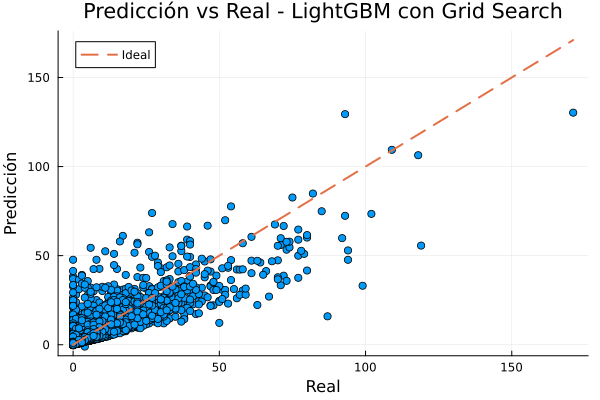

In [85]:
using MLJ
using MLJTuning
using LightGBM
using Plots

const LGBMRegressor = LightGBM.MLJInterface.LGBMRegressor

# Modelo base
model = LGBMRegressor(
    objective = "regression",
    metric = ["l2"],
    verbosity = -1
)

# Rangos hiperparámetros para buscar
r_learning_rate    = range(model, :learning_rate, lower=0.01, upper=0.3)
r_num_leaves       = range(model, :num_leaves, lower=10, upper=100)
r_min_data_in_leaf = range(model, :min_data_in_leaf, lower=5, upper=50)

ranges = [r_learning_rate, r_num_leaves, r_min_data_in_leaf]

# Configuración de búsqueda: GRID con resolución 10 (10 valores por parámetro)
tuning = Grid(resolution=10)

tm = TunedModel(
    model = model,
    tuning = tuning,
    resampling = Holdout(fraction_train=0.8, shuffle=true),
    range = ranges,
    measure = l2,
    acceleration = CPUThreads()
)

# Datos
X = MLJ.table(X_train_matrix)
y = y_train_vector

# Máquina y entrenamiento
mach = machine(tm, X, y)
fit!(mach)

# Predicción
ŷ_opt = predict(mach, MLJ.table(X_test_matrix)) |> collect

# Métricas
mae_opt = mean(abs.(ŷ_opt .- y_test_vector))
r2_opt  = 1 - sum((y_test_vector .- ŷ_opt).^2) / sum((y_test_vector .- mean(y_test_vector)).^2)

println(("LightGBM_MLJ_GridSearch", "SUCCESS", mae_opt, r2_opt))

# Gráfico Pred vs Real
scatter(y_test_vector, ŷ_opt,
    xlabel = "Real",
    ylabel = "Predicción",
    title = "Predicción vs Real - LightGBM con Grid Search",
    label = "",
    legend = :topleft,
)
plot!(identity, label = "Ideal", lw = 2, ls = :dash)
